In [1]:
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib.pylab as plt
import matplotlib.colors as colors
import matplotlib.patches as patches
import torchvision
import matplotlib.patches as patches
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D

import os
import time
import torch
import sys
import argparse
sys.path.insert(0, '../../shared_code')
from model_loader_func import * 
from dataloader_func import *
from quality_metrics_func import *
from linear_approx import *
from inverse_tasks_func import synthesis
from plotting_func import *
from algorithm_inv_prob import * 
from trainer import make_loader
%matplotlib inline

In [2]:
print(torch.__version__)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
device

2.5.0+cu124


device(type='cuda')

# functions 

In [3]:
## plotting stuff: 
noise_colormap = plt.cm.copper 
scale_colormap = plt.cm.seismic


In [4]:
similarity_matrix = lambda data : data/data.norm(dim = 1, keepdim=True) @(data/data.norm(dim = 1, keepdim=True)).T
similarity_vactor = lambda data, v : (v/(v.norm(dim = 1, keepdim=True)+1e-6) @(data/(data.norm(dim = 1, keepdim=True) +1e-6 ) ).T).flatten()
similarity_matrix_2mats = lambda data1, data2 : data1/data1.norm(dim = 1, keepdim=True) @(data2/data2.norm(dim = 1, keepdim=True)).T

degree_matrix = lambda sim_mat : torch.diag(sim_mat.sum(dim = 1))

participation_ratio = lambda v :  (v.norm(1)**2)/v.norm(2)**2/len(v)
participation_ratio_dataset = lambda data :  (data.norm(1, dim = 1)**2)/data.norm(2,dim = 1)**2/data.shape[1]


# Load denoisers 

In [5]:
denoisers = {}

root_path = '/mnt/home/zkadkhodaie/ceph/22_representation_in_UNet_denoiser/denoisers/'

paths = {                
         'mixture-color-deep-no-skip-full':'UNet_flex/imagenet/0to255_RF_84x84_set_size_1281167_color_no_skip_deep_dec_full_64x64/',
    
         'mixture-color-deep-no-skip-subset':'UNet_flex/imagenet/0to255_RF_84x84_set_size_256954_color_no_skip_deep_dec_subset_64x64/',    

        }

groups = paths.keys()


for group in groups: 
    path = root_path + paths[group]
    
    print('loading group ' , group )
    if 'modified' in group.split('-'):
        new_arch = 'UNet_conditional_mean_matching'
    else: 
        new_arch = None
    denoisers[group] = load_learned_model(path, print_args=True, new_arch=new_arch)
    start_time_total = time.time()        
    print("--- %s seconds ---" % (round(time.time() - start_time_total)))
     

loading group  mixture-color-deep-no-skip-full
*************** saved arguments:*************
arch_name UNet_flex
lr 0.001
batch_size 4096
num_epochs 2000
lr_freq 100
loss_weight False
noise_level_range [0, 255]
quadratic_noise True
rescale False
swap False
set_size 1281167
imagenet_subset_ids None
data_name imagenet
data_root_path /mnt/home/zkadkhodaie/ceph/datasets/
dir_name /mnt/home/zkadkhodaie/ceph/22_representation_in_UNet_denoiser/denoisers/UNet_flex/imagenet/0to255_RF_84x84_set_size_1281167_color_no_skip_deep_dec_full_64x64
optional_dir_label color_no_skip_deep_dec_full
device cuda
debug False
kernel_size 3
padding 1
skip False
num_channels 3
bias True
RF 84
coarse True
self_cond False
num_kernels [64, 128, 256, 512]
num_blocks 3
num_enc_conv [2, 2, 2]
num_mid_conv 3
num_dec_conv [6, 6, 6]
NormType LayerNorm
inter_skip True
dilations None
upsample_with_bias False
data_path /mnt/home/zkadkhodaie/ceph/datasets/imagenet
******************************************************
number 

In [10]:
denoisers.keys()

dict_keys(['mixture-color-deep-no-skip-full', 'mixture-color-deep-no-skip-subset'])

In [11]:
layers = {}
for group in groups:
    layers[group] = []
    for i in range(len(denoisers[group].encoder)):
        layers[group].append(denoisers[group].encoder[str(i) ][0].weight.shape[0])
    
    layers[group].append(denoisers[group].mid[0].weight.shape[0])
    
    for i in range(len(denoisers[group].decoder)-1 , 0, -1):
        layers[group].append(denoisers[group].decoder[str(i) ][0].weight.shape[0])


layers

{'mixture-color-deep-no-skip-full': [64, 128, 256, 512, 256, 128],
 'mixture-color-deep-no-skip-subset': [64, 128, 256, 512, 256, 128]}

In [12]:
block_names = {}
for group in groups: 
    block_names[group] = []
    for l in range(int(len(layers[group])/2)): 
        block_names[group].append('enc' + str(l))
    block_names[group].append('mid'  )        
    for l in range(int(len(layers[group])/2)-1, 0,-1):
        block_names[group].append('dec' + str(l) )
block_names   

{'mixture-color-deep-no-skip-full': ['enc0',
  'enc1',
  'enc2',
  'mid',
  'dec2',
  'dec1'],
 'mixture-color-deep-no-skip-subset': ['enc0',
  'enc1',
  'enc2',
  'mid',
  'dec2',
  'dec1']}

# Load datasets 

In [13]:
time0 = time.time()
test_sets = torch.load( '/mnt/home/zkadkhodaie/ceph/datasets/imagenet/validation_color_full_64x64_list.pt', weights_only=True) 
print(f"loading time: {time.time() - time0} seconds ")

loading time: 32.0851776599884 seconds 


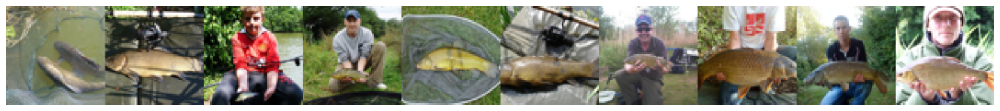

In [14]:
show_im_grid(test_sets[0][0:10] )


In [15]:
print('number of images in each class:', test_sets[0].shape)
K = test_sets[0].shape[2]
n_channels = test_sets[0].shape[1]
print(len(test_sets))

number of images in each class: torch.Size([50, 3, 64, 64])
1000


tensor(0.4424)


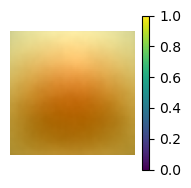

In [16]:
dist_mean = torch.concatenate(test_sets).mean(dim = (0))
plot_single_im(dist_mean, colorbar=True)
print(dist_mean.mean())

In [17]:
dist_mean.mean(dim = (1,2), keepdim = True)

tensor([[[0.4764]],

        [[0.4504]],

        [[0.4005]]])

In [18]:
test_sets_cat = torch.concatenate(test_sets)
test_sets_cat.shape

torch.Size([50000, 3, 64, 64])

In [155]:
imagenet_subset_ids= torch.tensor([580, 172, 199, 396, 906, 221, 740, 845, 455, 201, 887, 673, 814,  81,
        678, 961, 839,  29, 879,  82, 974, 427, 721, 310, 530, 504, 312, 748,
        291, 600, 459, 484, 741, 712, 301, 621, 702, 769, 193, 282, 805, 680,
        422, 145,  50, 258, 787, 177, 960, 726, 437, 585, 624, 178, 790, 236,
        237, 197, 186, 121, 656, 801, 823, 133, 923, 804, 505, 674, 419, 606,
        880, 179, 827, 294, 376, 160, 433, 143, 467, 238, 454, 793, 107, 285,
        441, 519, 468, 346, 777,  57, 746, 187, 720, 185, 770, 475, 947, 595,
        314, 118, 173, 857, 892, 805, 243, 693, 388, 484, 602, 101, 932, 565,
        145, 710, 958,  33, 863, 861, 561, 212, 717, 594, 553, 645, 417, 311,
         29, 495, 395, 495, 416, 211, 307,  96, 794, 417, 330, 880, 910, 735,
        479, 282, 189, 777, 959, 779, 523, 829, 820, 705, 608, 947, 797, 407,
        905, 257,  74,  96, 760, 869, 348, 403, 763,  46, 794, 532, 766, 801,
        290,  11,  19, 802, 915, 334, 891, 740, 207, 221, 776, 910, 231, 281,
        746, 938, 220, 241, 896, 856, 832, 666, 844, 142, 997, 828, 365, 601,
        109, 209, 614, 274])

imagenet_subset_ids = imagenet_subset_ids.sort()[0]
print(imagenet_subset_ids)
my_ims = torch.cat([test_sets[i][0:10] for i in imagenet_subset_ids ])
print(len(my_ims))
# show_im_grid(my_ims, n_columns=20)


test_sets_sub = [test_sets[i] for i in imagenet_subset_ids ]
print(torch.cat(test_sets_sub).shape)

test_sets_sub_cat = torch.concatenate(test_sets_sub)  ## this is without replacement 


tensor([ 11,  19,  29,  29,  33,  46,  50,  57,  74,  81,  82,  96,  96, 101,
        107, 109, 118, 121, 133, 142, 143, 145, 145, 160, 172, 173, 177, 178,
        179, 185, 186, 187, 189, 193, 197, 199, 201, 207, 209, 211, 212, 220,
        221, 221, 231, 236, 237, 238, 241, 243, 257, 258, 274, 281, 282, 282,
        285, 290, 291, 294, 301, 307, 310, 311, 312, 314, 330, 334, 346, 348,
        365, 376, 388, 395, 396, 403, 407, 416, 417, 417, 419, 422, 427, 433,
        437, 441, 454, 455, 459, 467, 468, 475, 479, 484, 484, 495, 495, 504,
        505, 519, 523, 530, 532, 553, 561, 565, 580, 585, 594, 595, 600, 601,
        602, 606, 608, 614, 621, 624, 645, 656, 666, 673, 674, 678, 680, 693,
        702, 705, 710, 712, 717, 720, 721, 726, 735, 740, 740, 741, 746, 746,
        748, 760, 763, 766, 769, 770, 776, 777, 777, 779, 787, 790, 793, 794,
        794, 797, 801, 801, 802, 804, 805, 805, 814, 820, 823, 827, 828, 829,
        832, 839, 844, 845, 856, 857, 861, 863, 869, 879, 880, 8

In [163]:
imagenet_subset_ids.unique().shape

torch.Size([183])


$\phi(y)$ or the mean of the channel is a function of noise realization, noise level, and input image. 

- **noise realization**: We take the average of $\phi(y)$ at a noise level, for one image to remove the effect of noise realization. 

- **noise level**: We observe that the $\phi(y_{\sigma})$ and $\phi(y_{\sigma})$ at two different noise levels are highly related: first, active channels are mostly shared at different noise levels. Specially at intermediate and larger noise levels. There are more active channels at high noise levels and they include active channels at smaller noise levels. Second, they are highly correlated. That means they are aligned and differ by a poitive scalre value.

- **input image $x$**: after getting rid of noise effect, we can look at how $\phi(y)$ changes from image to image. We can interpret $\phi(y)$ as a good approximation of $\phi(x)$. Now we ask if  Euclidean distance in latent space $\Vert \phi(x_1) -  \phi(x_2) \Vert_2$ is meaningfully related to $\mathcal{D}(x_1, x_2)$ where $\mathcal{D}$ is a some distance metric between the two images. Since $\phi(x)$ is a many to one mapping, we can define a distance between the density of all images mapping to $\phi(x_1)$ and the density of all images mapping to $\phi(x_2)$, that is $\mathcal{D}( p(x|\phi(x_1), p(x|\phi(x_2)) )$. 

In [20]:
# a_bars = torch.load('../results/phis_noise_ave_all_scales_64x64_mixture-color-no-skip-deep_imagenet.pt', weights_only=True)
a_bars = {}
for group in groups: 
    print(group)
    a_bars[group] = torch.load('../results/a_bar_noise_ave_validation_full_'+group+'_imagenet64x64.pt', weights_only = True)


mixture-color-deep-no-skip-full
mixture-color-deep-no-skip-subset


In [21]:
sigmas = list(a_bars[group].keys())
if sigmas[-1] < sigmas[0]:
    sigmas.reverse()
sigmas

[0, 10, 50, 150, 255]

In [22]:
# phis = torch.load('../results/phis_noise_ave_64x64_mixture-color-no-skip-deep_imagenet.pt', weights_only = True)


phis = {}
for group in groups:
    phis[group] ={}
    for sig in a_bars[group].keys():
        mid = int(len(layers[group])/2)
        phis[group][sig] = [a_bars[group][sig][i][:, sum(layers[group][0:mid]): sum(layers[group][0:mid+1]) ] for i in range(len(a_bars[group][sig]))]
    

In [23]:
# ch_selectivity=torch.cat(phis[group][sig]).norm(1, dim = 0).cpu()**2 / torch.cat(phis[group][sig]).norm(2, dim = 0).cpu()**2/torch.cat(phis[group][sig]).shape[0]
ch_selectivity = {}
ids_selectivity_sorted = {}
for group in groups:
    ch_selectivity[group] = {}
    ids_selectivity_sorted[group] = {}
    for sig in sigmas:
        
        ch_selectivity[group][sig] = participation_ratio_dataset(torch.cat(phis[group][sig]).T.cpu())
        ch_selectivity[group][sig]= torch.nan_to_num(ch_selectivity[group][sig], nan=0.0)
        ids_selectivity_sorted[group][sig] = ch_selectivity[group][sig].sort(descending =True)[1]
        


# Compare denoising performance 

In [214]:
## compute psnr 
sig_range = torch.logspace(.0001,4,15)

psnr_test = {}
# psnr_train = {}
for group in groups: 
    
    ## train 
    print(group)
    if 'gray' in group.split('-'): 
        loader = DataLoader(dataset=my_ims.mean(dim =1, keepdim=True), batch_size=512, shuffle=False)
    else: 
        loader = DataLoader(dataset=my_ims, batch_size=512, shuffle=False)
            
    try: 
        psnr_test[group] = calc_psnr(denoisers[group],loader,sig_range, device, skip=False)
    except KeyError: 
        pass


mixture-color-deep-no-skip-full
mixture-color-deep-no-skip-subset


mixture-color-deep-no-skip-full
mixture-color-deep-no-skip-subset


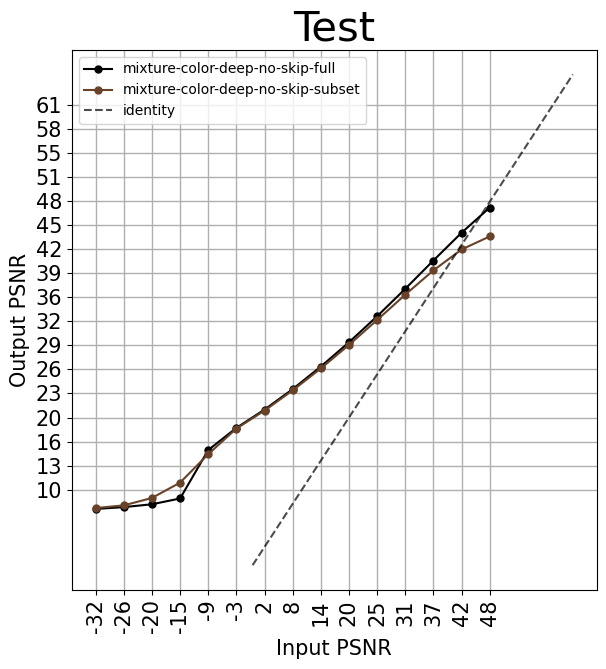

In [215]:
## plot 
f , axs = plt.subplots(1,1, figsize=(6,6), sharex = True, sharey=True)
plt.tight_layout()
x_axis = [ -10*np.log10( (float(std)/255)**2  ) for std in psnr_test[group].keys()]

for group in groups: 
    print(group)
    if 'color' in group.split('-'):
        ## test 
        axs.plot(x_axis, [psnr_test[group][key] for key in psnr_test[group].keys()], 
                    marker = '.',markersize = 10,label =  group , alpha = 1)

axs.set_xticks(x_axis);
axs.grid(  linewidth=1);
axs.set_xticklabels(np.round(x_axis).astype(int) ,rotation=90, fontsize=15)
# axs.set_xlim(-3, 45)

y_axis = np.linspace(10,61,17) 
axs.set_yticks(y_axis);
axs.set_yticklabels(np.round(y_axis).astype(int) , fontsize=15);
# axs.set_ylim(18, 45)


colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [colormap(i) for i in np.linspace(0, 1, 3+1)]
for k,j in enumerate(axs.lines):
    j.set_color(plot_colors[k])
# axs.plot(x_axis, [ -10*np.log10( (std/255)**2  ) for std in sig_range/K ],linestyle = 'dotted', label = 
            # 'expected from 1d manifold(N=1)', color='gray')
axs.plot( [0,48],[0,48] ,'k--', alpha = .7, label = 'identity');
axs.legend(fontsize = 10);
axs.set_title('Test', fontsize = 30)
axs.set_xlabel('Input PSNR', fontsize = 15)
axs.set_ylabel('Output PSNR', fontsize = 15);


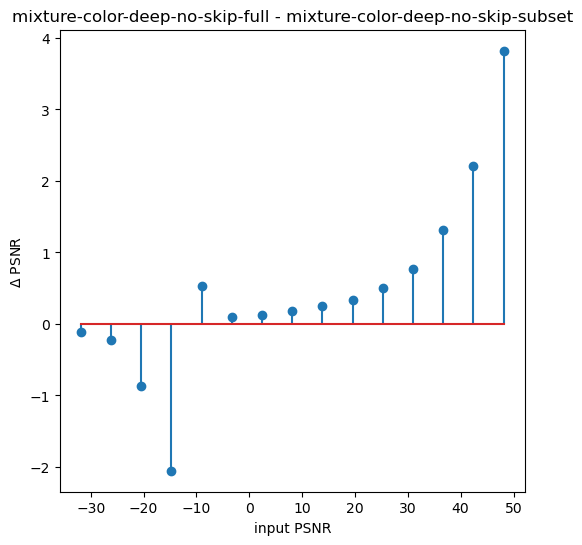

In [39]:
denoiser1 =  'mixture-color-deep-no-skip-full'
denoiser2 = 'mixture-color-deep-no-skip-subset'

f , axs = plt.subplots(1,1, figsize=(6,6), sharex = True, sharey=True)

axs.stem(x_axis,[psnr_test[denoiser1][key] - psnr_test[denoiser2][key] for key in psnr_test[group].keys()])
axs.set_xlabel('input PSNR')
axs.set_title(denoiser1+ ' - '+ denoiser2)
axs.set_ylabel('$\Delta$ PSNR');


## Always off channels 

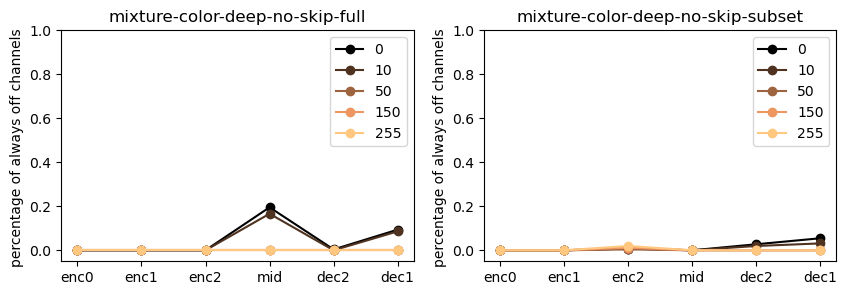

In [40]:
f, axs = plt.subplots(1, len(groups), figsize = ( len(groups)*5, 3) )

j = 0
for group in groups:
    off_channels = {}
    for sig in sigmas:
        off_channels[sig] = []
        k1 = 0
        for l in layers[group]: 
            phi_block = torch.cat(a_bars[group][sig])[:,k1:k1 + l]
            off_channels[sig].append((phi_block.sum(dim = 0) == 0).sum().item())
            k1 += l  
            
    plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas ))]
    
    c = 0
    for sig in sigmas:    
        axs[j].plot(block_names[group], torch.tensor(off_channels[sig])/torch.tensor(layers[group]), '-o', color = plot_colors[c],  label = sig)
        c+= 1
    axs[j].set_ylabel('percentage of always off channels ');
    axs[j].set_ylim(-.05,1)
    axs[j].legend();
    axs[j].set_title(group);
    j += 1

# Initialization: Reprensetation of Gaussian samples 

In [41]:
group =  'mixture-color-deep-no-skip-full'

In [42]:
Gaussian_samples = torch.randn(1024, 3, K, K) + .45
phi_gaus = get_activation_means_unconditional(denoisers[group], Gaussian_samples)

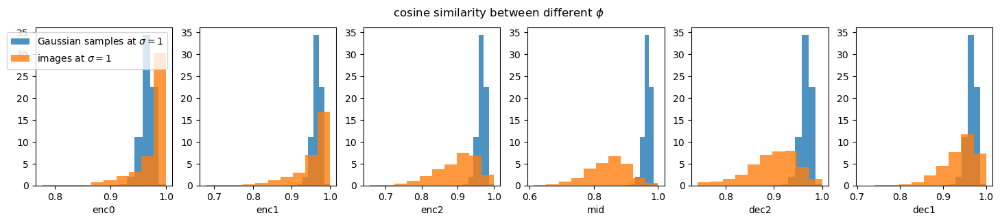

In [43]:
f, axs = plt.subplots(1, len(layers[group]), figsize = (len(layers[group])* 3, 3) )
f.suptitle('cosine similarity between different $\phi$'); 
for i in range(len(layers[group])):
    axs[i].hist(similarity_matrix(phi_gaus[3].cpu()).flatten() , density=True,  alpha = .8, label = 'Gaussian samples at $\sigma=1$'); 
    axs[i].hist(similarity_matrix(torch.cat(a_bars[group][255])[0::1000, sum(layers[group][0:i]):sum(layers[group][0:i+1])  ].cpu()).flatten() 
                , alpha = .8, density=True, label = 'images at $\sigma=1$'); 
    axs[i].set_xlabel(block_names[group][i])
axs[0].legend();


mixture-color-deep-no-skip-full
mixture-color-deep-no-skip-subset


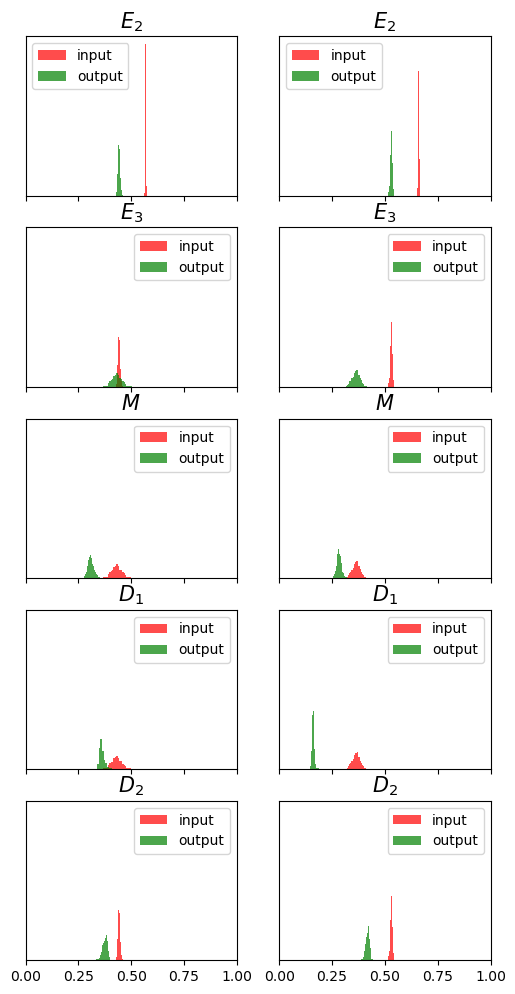

In [44]:
f,axs = plt.subplots( len(layers[group])-1, len(groups), figsize = (len(groups)*3, len(layers[group]) * 2 ) , sharey=True,sharex=True)
c = 0
for group in groups:
    phi_gaus = get_activation_means_unconditional(denoisers[group], Gaussian_samples)

    all_participation_ratio = []
    for b in range(len(phi_gaus)): 
            all_participation_ratio.append(participation_ratio_dataset(phi_gaus[b]))
    
    block_pairs = {'$E_2$': (0,1) , 
              '$E_3$': (1,2), 
              '$M$': (2,3), 
              '$D_1$': (2,4),
              '$D_2$':(1,5)}
    plt.rc('xtick', labelsize=12)       
    r = 0
    for b, pairs in block_pairs.items():
        
        axs[r,c].hist( all_participation_ratio[pairs[0]].cpu() ,alpha = .7, color='red', label = 'input', density=True, bins=20)
        axs[r,c].hist( all_participation_ratio[pairs[1]].cpu() ,alpha = .7, color='green', label = 'output', density=True, bins=20 )
        axs[r,c].set_title(b, fontsize=15 );
        # ax.set_xlabel('participation ratio', fontsize=15 );
        axs[r,c].set_xlim(0,1)
        axs[r,c].set_yticks([])
        axs[r,c].set_yticks([])    
        axs[r,c].legend();
        r += 1
        # plt.savefig('../results/participation_ratios_unet_hist_'+b.split('$')[1]+'_.pdf',bbox_inches='tight')    
    print(group)    
    c += 1

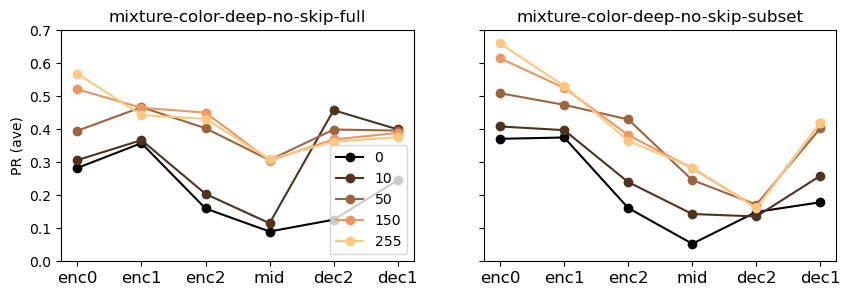

In [45]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(a_bars[group ].keys()))]
f, axs = plt.subplots(1, len(groups), figsize = ( len(groups)*5, 3) , sharey=True)

j = 0
for group in groups:
    c = 0
    for sig in sigmas:
        phi_gaus = get_activation_means_unconditional(denoisers[group], Gaussian_samples* sig/255     ) 
            
        all_participation_ratio_mean = []
        for b in range(len(phi_gaus)): 
            all_participation_ratio_mean.append(participation_ratio_dataset(phi_gaus[b]).mean().cpu())        

        
        axs[j].plot(block_names[group], all_participation_ratio_mean, '-o', color = plot_colors[c],  label = sig)
        axs[j].set_title(group)
        axs[j].set_ylim(0,.7)
        c+= 1
    j +=1
axs[0].set_ylabel('PR (ave)');
axs[0].legend();

sparser than image distribution 

## images whose $\phi$ at $\sigma = 1$ is most similar to $\phi$ of Gaussian samples $\sigma = 1$

In [72]:

group = 'mixture-color-deep-no-skip-full'
sig = 255
noise = torch.randn(5, 3, 64, 64) * 3*  sig/255 
Gaussian_samples =  noise +  dist_mean.mean() 

phi_gaus = get_activation_means_unconditional(denoisers[group], Gaussian_samples    ) 
Gaussian_samples_denoised = denoisers[group](Gaussian_samples.cuda()).detach()


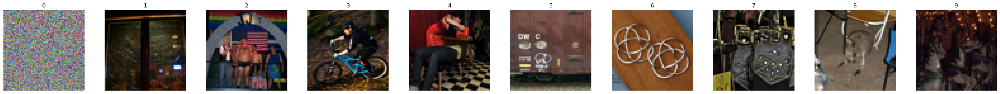

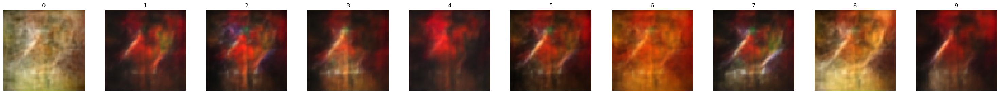

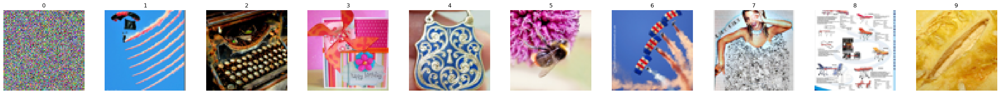

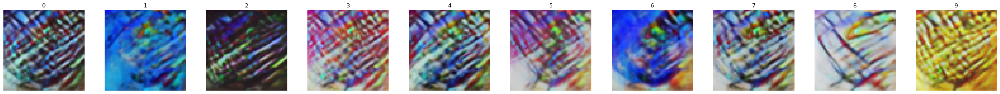

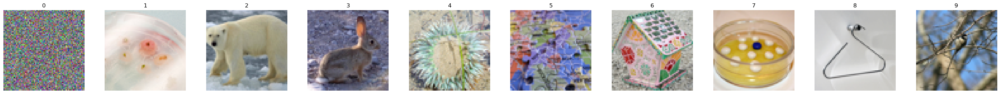

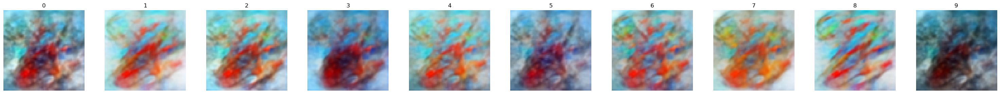

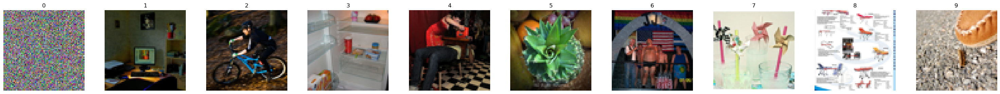

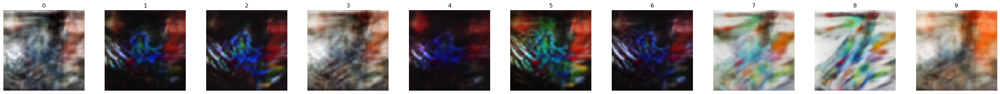

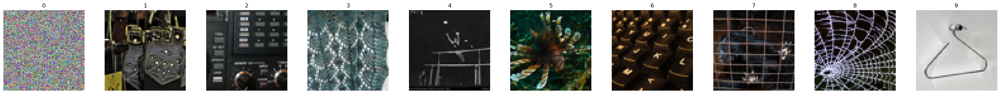

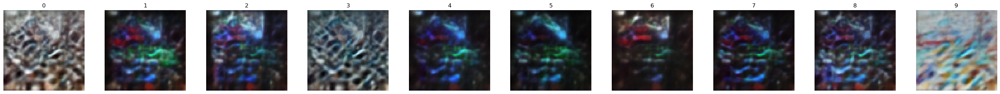

In [73]:

for i in range(0, 5):
    sims = similarity_vactor(phi_gaus[3][i:i+1].cpu(), torch.cat(phis[group][sig]).cpu()  )
    denoised = denoisers[group](test_sets_cat[sims.sort()[1][-9::]].cuda() + noise[i:i+1].cuda() ).detach().cpu() #add same sample of nosie 
    show_im_set(torch.cat([Gaussian_samples[i:i+1].cpu(), test_sets_cat[sims.sort()[1][-9::]] ])) 
    show_im_set(torch.cat([Gaussian_samples_denoised[i:i+1].cpu(), denoised.cpu() ])) 



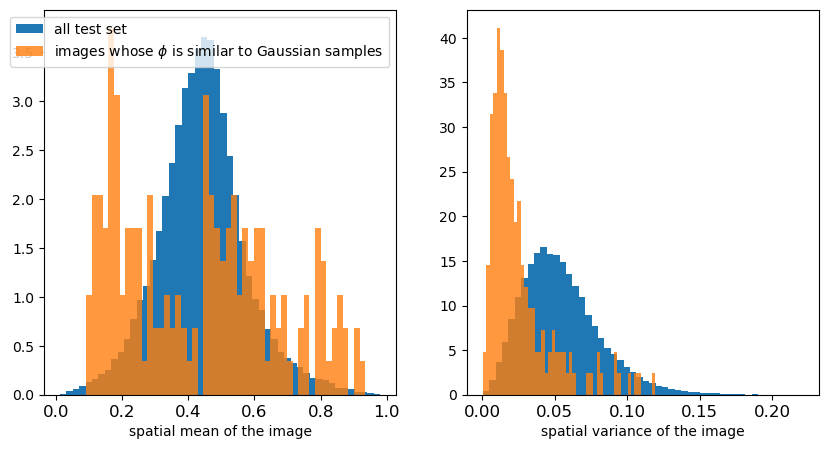

In [74]:
sig = 255
noise = torch.randn(2000, 3, 64, 64) * 3* sig/255 
Gaussian_samples =  noise +dist_mean.mean() 
phi_gaus = get_activation_means_unconditional(denoisers[group], Gaussian_samples    ) 

sims = similarity_matrix_2mats(phi_gaus[3].cpu(), torch.cat(phis[group][sig]).cpu()  )

f, axs = plt.subplots(1, 2, figsize = ( 2*5,5 ) , sharey=False)


axs[0].hist(test_sets_cat.mean(dim = (1,2,3))   , bins= 50 , label = 'all test set ', density = True);
axs[0].hist(test_sets_cat[sims.topk(1 , dim = 1)[1].unique()].mean(dim = (1,2,3)), bins= 50 , 
         label = 'images whose $\phi$ is similar to Gaussian samples', density = True, alpha = .8);
axs[0].legend()
axs[0].set_xlabel('spatial mean of the image');

axs[1].hist(test_sets_cat.var(dim = (1,2,3))   , bins= 50 , label = 'all test set ', density = True);
axs[1].hist(test_sets_cat[sims.topk(1 , dim = 1)[1].unique()].var(dim = (1,2,3)), bins= 50 , 
         label = 'images whose $\phi$ is similar to Gaussian samples', density = True, alpha = .8);
# axs[1].legend();
axs[1].set_xlabel('spatial variance of the image');

## Are the specialized channels off for the noise $\phi$s? 

torch.Size([148])


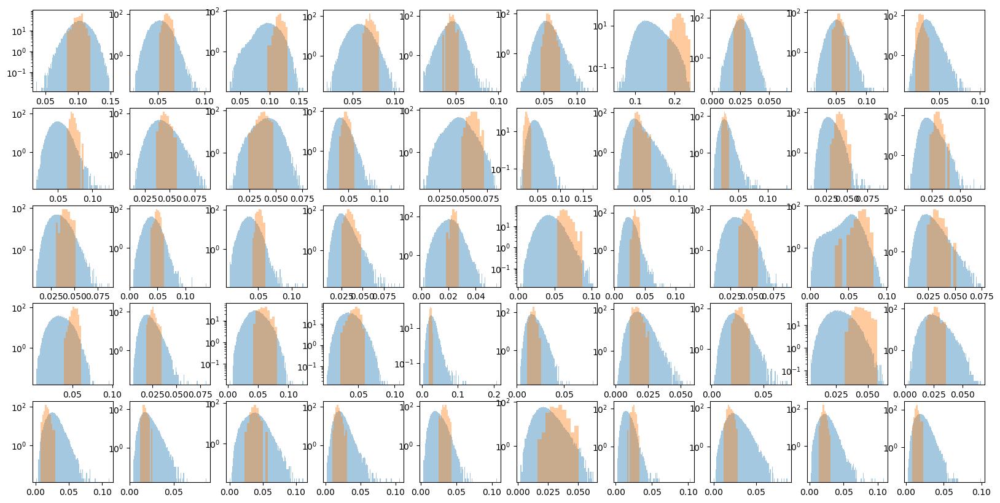

In [249]:
ids_sims = sims.topk(1 , dim = 1)[1].unique()
print(ids_sims.shape)
phis_sim = torch.cat(phis[255])[ids_sims] 

f, axs = plt.subplots(5,10, figsize = (20, 10))
axs = axs.ravel()
i = 0
for ch_n in range(0, 50): 
    axs[i].hist(torch.cat(phis[255]).cpu()[:, ids_selectivity_sorted[group][255].cpu() ][:,ch_n], density = True,  alpha = .4, bins = 100);
    axs[i].hist( phis_sim.cpu()[:, ids_selectivity_sorted[group][255].cpu() ][:,ch_n], alpha = .4, density = True);
    axs[i].set_yscale('log')
    i += 1

torch.Size([148])


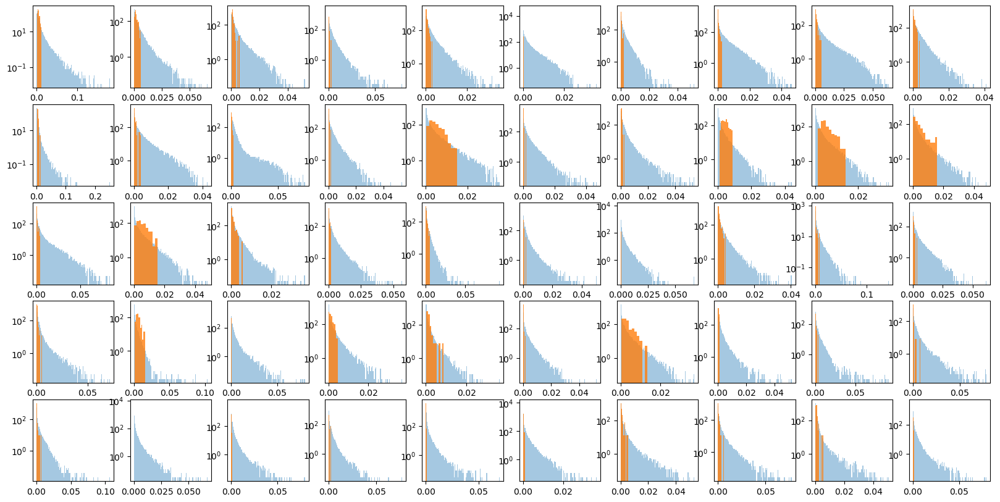

In [252]:
f, axs = plt.subplots(5,10, figsize = (20, 10))
axs = axs.ravel()
i = 0
for ch_n in range(250, 300): 
    axs[i].hist(torch.cat(phis[255]).cpu()[:, ids_selectivity_sorted[group][255].cpu() ][:,ch_n], density = True,  alpha = .4, bins = 100);
    axs[i].hist( phis_sim.cpu()[:, ids_selectivity_sorted[group][255].cpu() ][:,ch_n], alpha = .8, density = True);
    axs[i].set_yscale('log')
    i += 1

torch.Size([148])


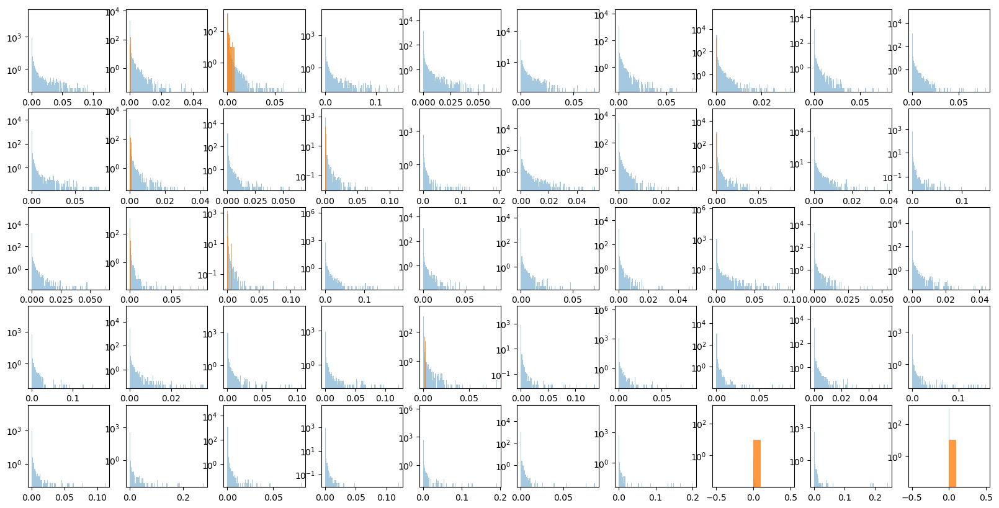

In [251]:
f, axs = plt.subplots(5,10, figsize = (20, 10))
axs = axs.ravel()
i = 0
for ch_n in range(462, 512): 
    axs[i].hist(torch.cat(phis[255]).cpu()[:, ids_selectivity_sorted[group][255].cpu() ][:,ch_n], density = True,  alpha = .4, bins = 100);
    axs[i].hist( phis_sim.cpu()[:, ids_selectivity_sorted[group][255].cpu() ][:,ch_n], alpha = .8, density = True);
    axs[i].set_yscale('log')
    i += 1
    

## which clusters contain images whose $\phi$'s are most similar to noise

In [204]:
with open('../results/kmeans_noise_ave_mixture-color-no-skip-deep_imagenet.pkl', 'rb') as f:
    kmeans_results = pickle.load(f)

In [205]:
clusters_noise_labels  = np.unique(kmeans_results[255][999].labels_[sims.topk(1 , dim = 1)[1].unique()])
clusters_noise_labels

array([166, 255, 438, 483, 500, 533, 548, 563, 600, 630, 679, 756, 865,
       920], dtype=int32)

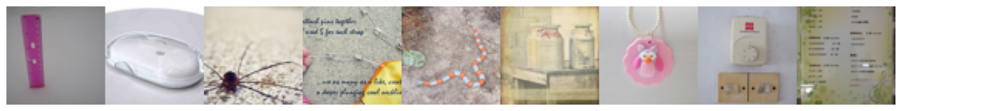

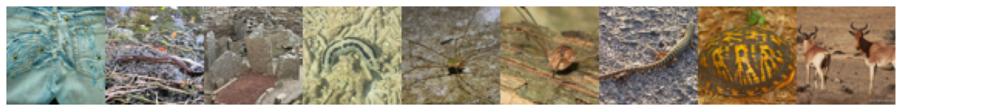

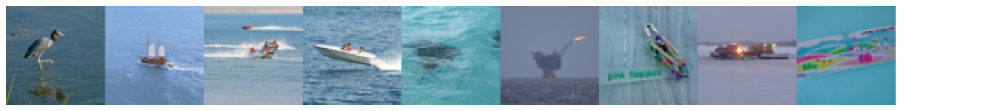

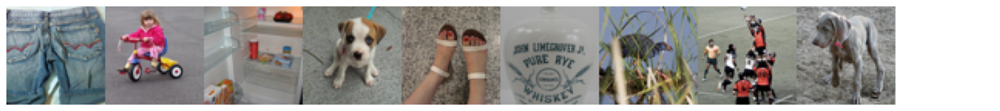

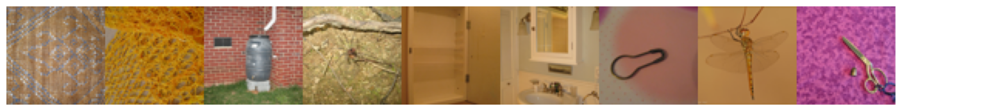

...

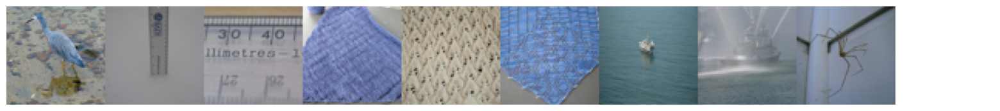

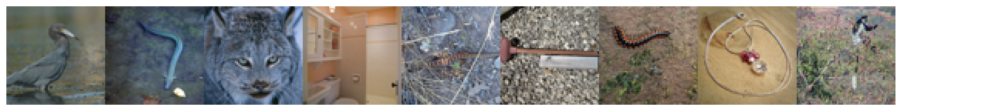

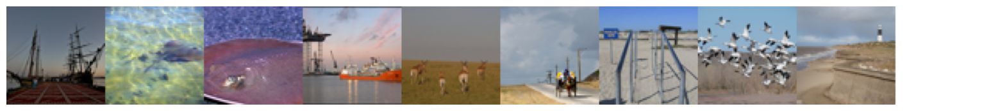

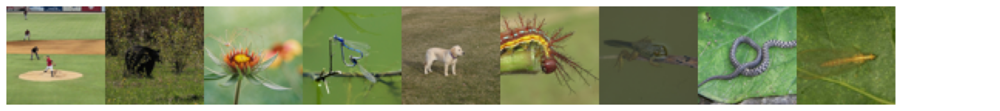

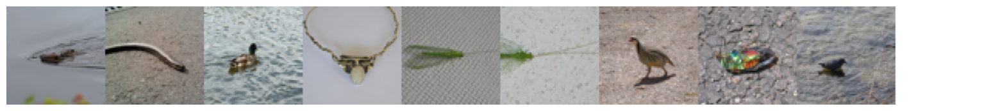

In [218]:
clusters_noise_labels  = np.unique(kmeans_results[255][999].labels_[sims.topk(1 , dim = 1)[1].unique()])
for c in clusters_noise_labels: 
    images_in_cluster = test_sets_cat[kmeans_results[255][999].labels_ ==  c ]
    show_im_grid(images_in_cluster[0:9] ) 
   

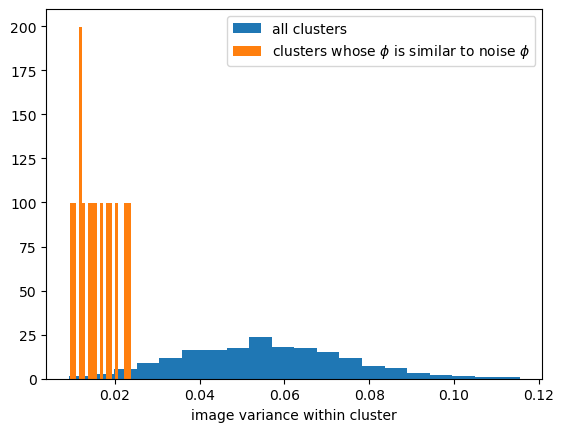

In [216]:
cluster_vars = []
for c in range(999): 
    images_in_cluster = test_sets_cat[kmeans_results[255][999].labels_ ==  c ]
    cluster_vars.append(images_in_cluster.var(dim = (1,2,3)).mean().item() )

my_clusters_vars = []
for c in clusters_noise_labels: 
    images_in_cluster = test_sets_cat[kmeans_results[255][999].labels_ ==  c ]
    my_clusters_vars.append(images_in_cluster.var(dim = (1,2,3)).mean().item() )

plt.hist(cluster_vars, bins = 20, label = 'all clusters', density = True)
plt.hist(my_clusters_vars, bins = 20, label = 'clusters whose $\phi$ is similar to noise $\phi$', density = True);
plt.xlabel( 'image variance within cluster')
plt.legend();

Text(0.5, 1.0, '$\\sigma = $ 1.0')

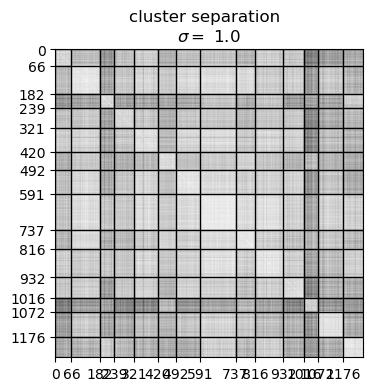

In [286]:
f, axs = plt.subplots(1,1, figsize = (4, 4))
f.suptitle('cluster separation')

# label_range = range(30, 40)
label_range = clusters_noise_labels
sig = 255
reorderd_phis = torch.cat([torch.cat(phis[group][250])[kmeans_results[sig][999].labels_ == c] for c in label_range])
lines = []
for l in label_range:
    lines.append((kmeans_results[sig][999].labels_ == l).sum())
ticks = [np.array(lines[0:l]).sum() for l in range(len(lines)) ]

axs.set_xticks(ticks )
axs.set_yticks(ticks )

axs.grid(color='k', linestyle='-', linewidth=1)

axs.imshow(similarity_matrix(reorderd_phis).cpu(), 'gray')
axs.set_title(f'$\sigma = $ {round(sig /255, 2)}')


# Synthesis

In [77]:
# init image mean set ot category mean. What's its effetc?

n_samples =30

seed = 0
freq =100
sig_L = .02
h0= .01
beta = .05

fixed_h =True
all_samples = {}
all_interm_Ys = {}
all_init = []
skip = True
start_time_total = time.time()

for group in groups: 
    if 'skip' in group.split('-'): 
        skip = False
    if seed is not None:
        torch.manual_seed(seed)
        

    
    print('--------- group : ', group)        
    all_samples[group] = {}
    all_interm_Ys[group] = {}            
    temp = []
    for _ in range(1):    
        if 'color' in group.split('-'): 
            n_channels = 3
            init_im = torch.ones((n_samples,n_channels ,K,K) ,device = device )*.45+ torch.randn(n_samples,n_channels ,K,K, device = device)*3
            
        else: 
            n_channels = 1        
            init_im = dist_mean.mean(dim=0,keepdim=True).to(device)+ torch.randn(n_samples,n_channels ,K,K, device = device) * 3

        
        sample, interm_Ys,_, _ = batch_synthesis(denoisers[group],
                                              (n_samples,n_channels, K,K),
                                              init_im=init_im, 
                                              sig_0=1, 
                                              sig_L=sig_L, 
                                              h0=h0, 
                                              beta=beta, 
                                              freq=freq,
                                              device=device, 
                                              fixed_h = fixed_h,
                                              max_T=10000, 
                                              seed= seed, 
                                              skip = skip
                                              )
                    
        temp.append(sample.detach())    
    
    all_samples[group] = torch.cat(temp)
    all_interm_Ys[group] = interm_Ys
    
            
print("--- %s seconds ---" % (time.time() - start_time_total))

--------- group :  mixture-color-deep-no-skip-full
----------------------------- 100
sigma  2.3973288536071777
mean  0.4315783381462097
----------------------------- 200
sigma  2.2589080333709717
mean  0.42252495884895325
----------------------------- 300
sigma  2.1271286010742188
mean  0.40506142377853394
----------------------------- 400
sigma  1.9990935325622559
mean  0.4042274057865143
----------------------------- 500
sigma  1.878799557685852
mean  0.39406123757362366
----------------------------- 600
sigma  1.7730344533920288
mean  0.3810074031352997
----------------------------- 700
sigma  1.6681501865386963
mean  0.3803897202014923
----------------------------- 800
sigma  1.573517918586731
mean  0.3802921772003174
----------------------------- 900
sigma  1.4842092990875244
mean  0.3764636516571045
----------------------------- 1000
sigma  1.3962819576263428
mean  0.3763517737388611
----------------------------- 1100
sigma  1.311872124671936
mean  0.37141478061676025
-----------

fixed_h= True  sig_L=  0.02  h0= 0.01  beta= 0.05  seed= 0


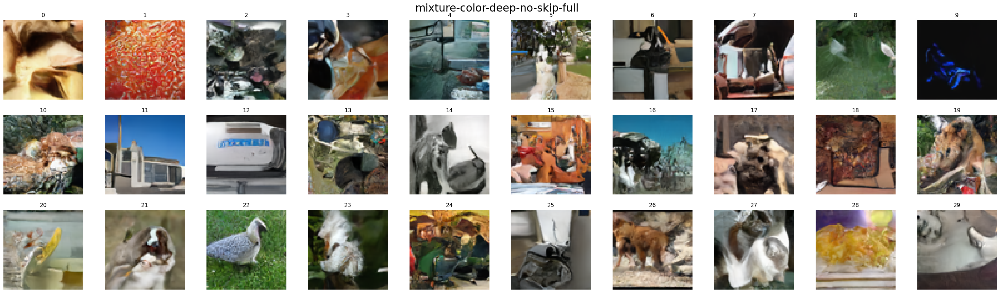

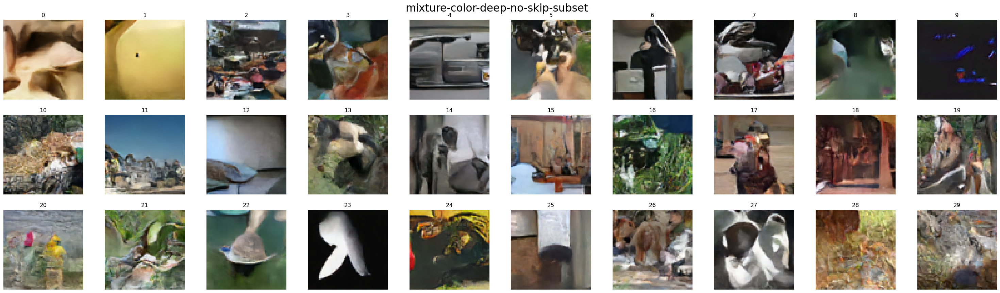

In [78]:
print('fixed_h=', fixed_h, ' sig_L= ',sig_L, ' h0=', h0, ' beta=',beta, ' seed=', seed)
for group in groups: 
    show_im_set(all_samples[group], n_columns=10, label=group)

In [180]:

sample_phis = {}
idx = {}

for group in groups:
    sample_phis[group] = {}
    idx[group] = {}
    for sig in sigmas:
        sample_phis[group][sig] = get_activation_means_unconditional(denoisers[group], all_samples[group] + sig/255 * torch.randn_like(all_samples[group]) )
        if 'subset' in group.split('-'):
            idx[group][sig] = similarity_matrix_2mats(sample_phis[group][sig][3].cpu(), torch.cat([phis[group][sig][i] for i in imagenet_subset_ids ] )).topk(10, dim = 1)[1]
            
        else: 
            idx[group][sig] = similarity_matrix_2mats(sample_phis[group][sig][3].cpu(), torch.cat(phis[group][sig])).topk(10, dim = 1)[1]
            



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


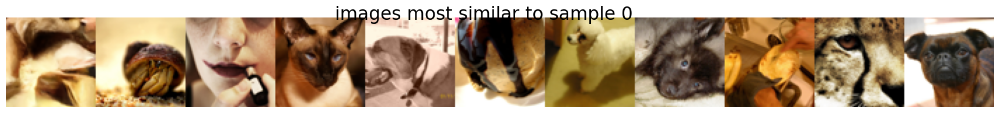

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


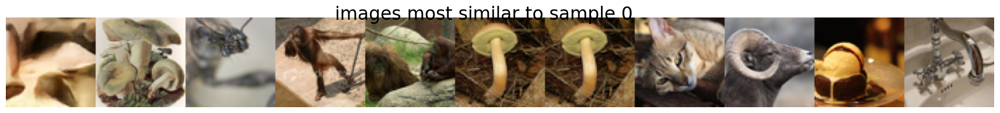

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


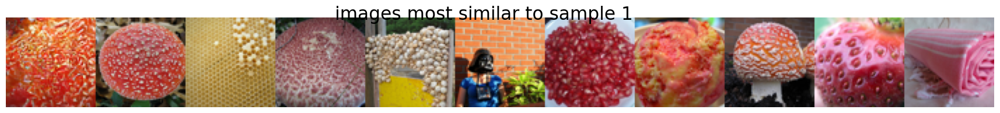

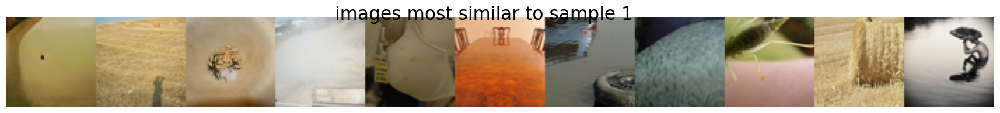

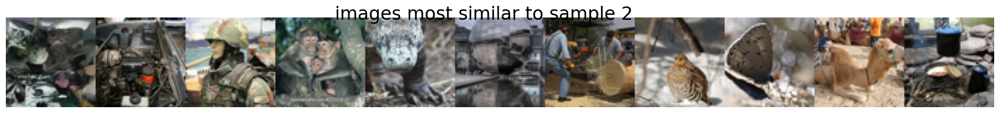

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


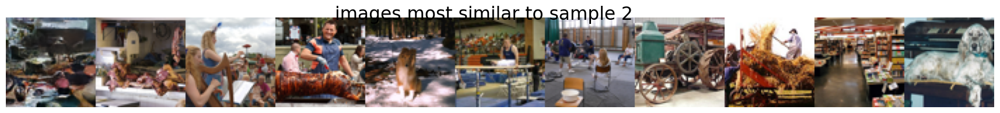

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


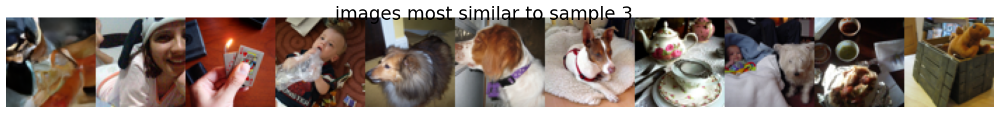

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


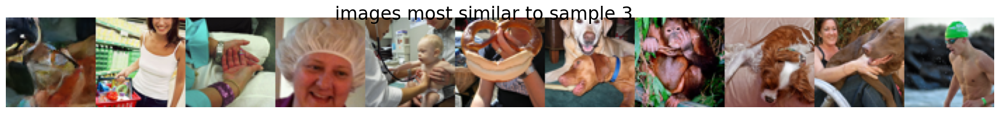

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


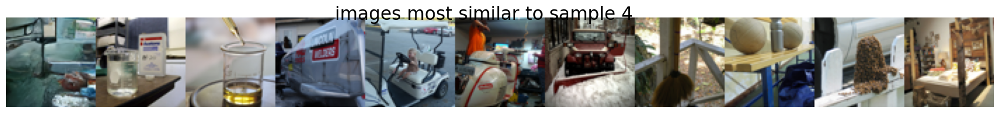

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


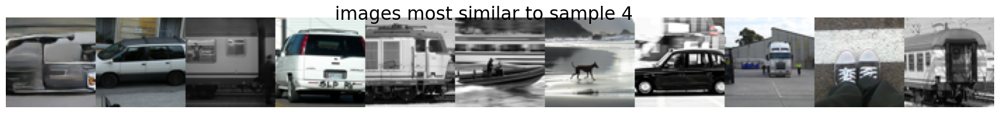

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


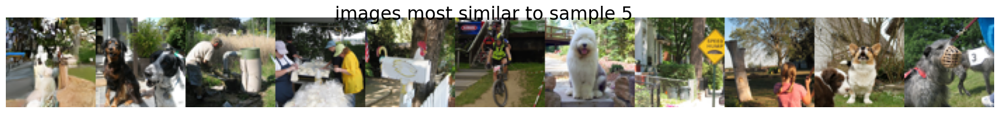

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


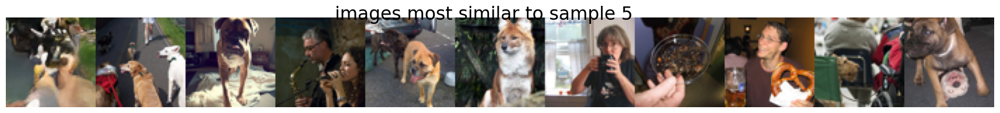

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


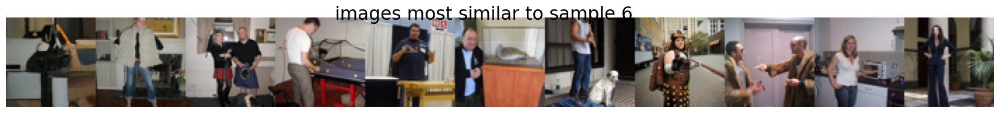

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


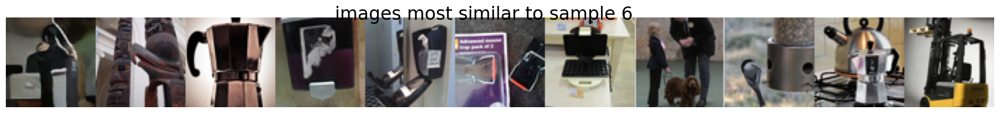

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


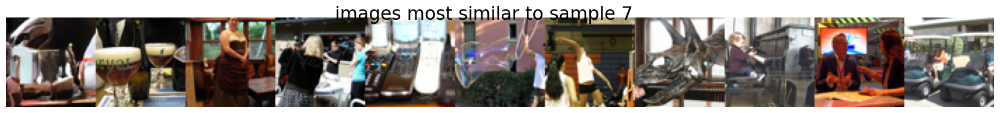

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


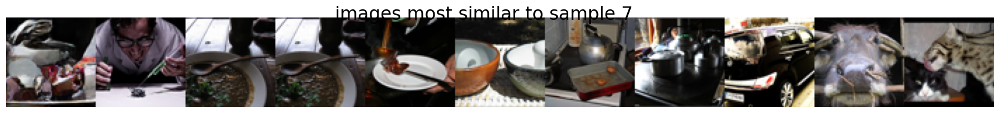

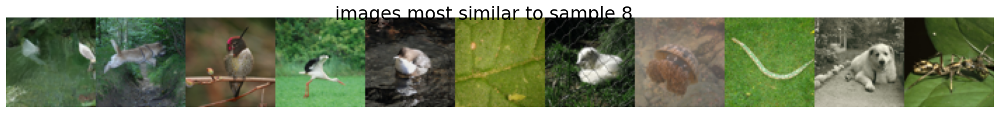

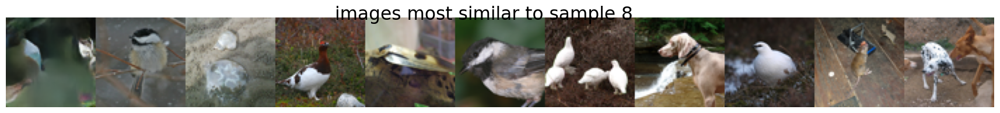

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


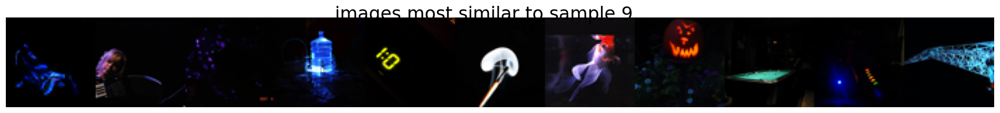

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


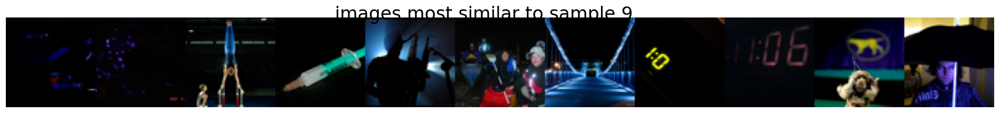

In [182]:
sig = 50
for im_n in range(0, 10):
    show_im_grid( torch.cat([all_samples['mixture-color-deep-no-skip-full'].cpu()[im_n:im_n+1], test_sets_cat[idx['mixture-color-deep-no-skip-full'][sig][im_n] ] ]) , 
             label='images most similar to sample '+ str(im_n), 
            n_columns= 11)
    show_im_grid( torch.cat([all_samples['mixture-color-deep-no-skip-subset'].cpu()[im_n:im_n+1], test_sets_sub_cat[idx['mixture-color-deep-no-skip-subset'][sig][im_n] ] ]) , 
             label='images most similar to sample '+ str(im_n), 
            n_columns= 11)    


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


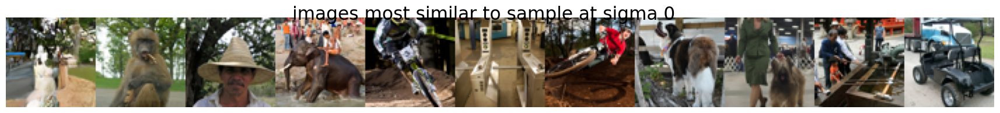

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


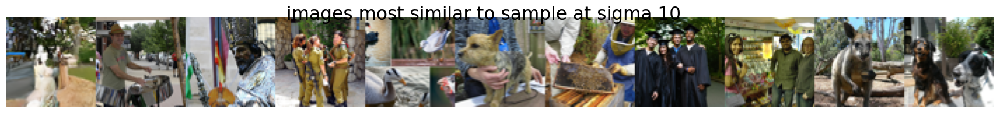

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


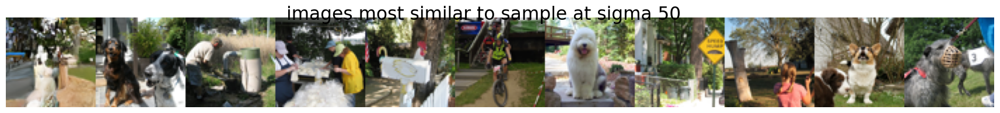

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


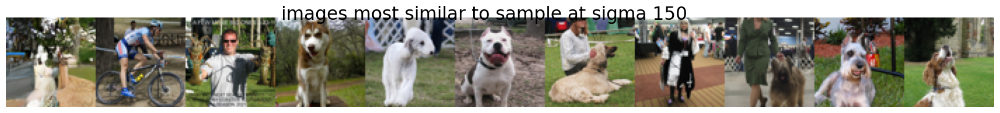

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


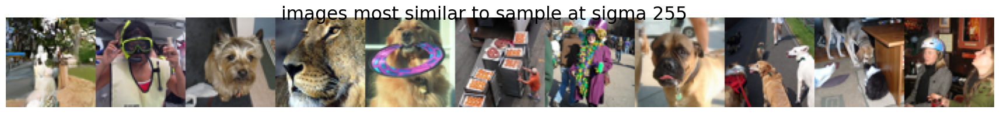

In [207]:
im_n = 5
for sig in sigmas:
    show_im_grid( torch.cat([all_samples['mixture-color-deep-no-skip-full'].cpu()[im_n:im_n+1], test_sets_cat[idx['mixture-color-deep-no-skip-full'][sig][im_n] ] ]) , 
             label='images most similar to sample at sigma '+ str(sig), 
            n_columns= 11)
  

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


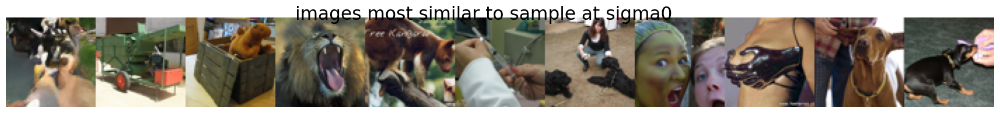

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


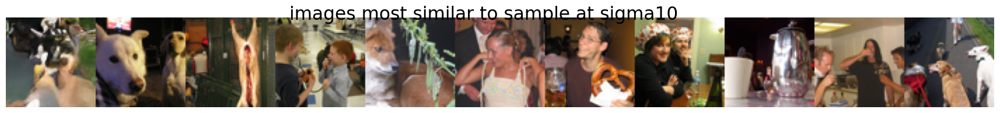

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


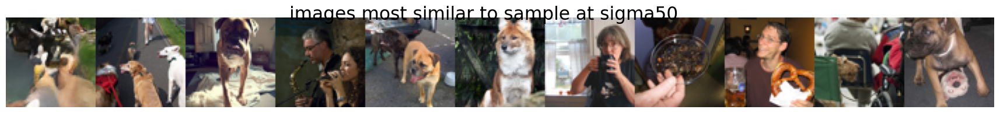

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


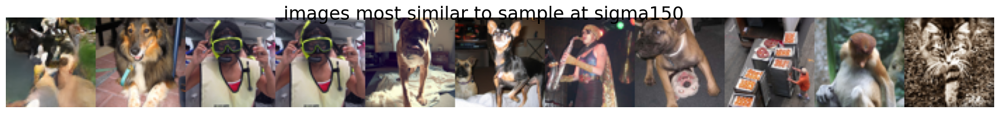

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


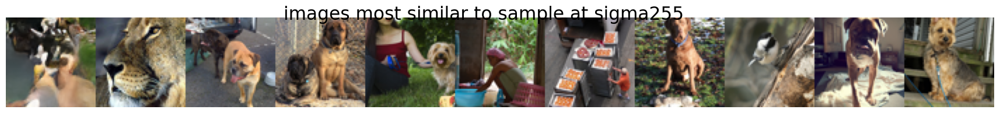

In [208]:
for sig in sigmas:  
    show_im_grid( torch.cat([all_samples['mixture-color-deep-no-skip-subset'].cpu()[im_n:im_n+1], test_sets_sub_cat[idx['mixture-color-deep-no-skip-subset'][sig][im_n] ] ]) , 
             label='images most similar to sample at sigma'+ str(sig), 
            n_columns= 11) 

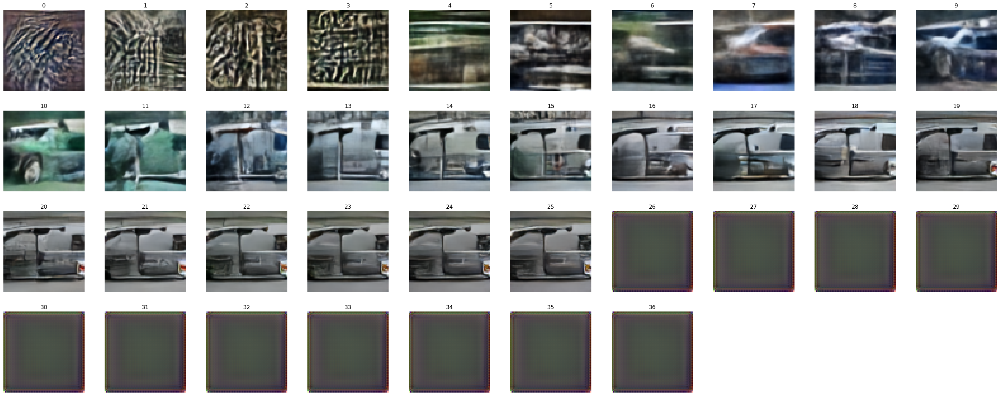

In [206]:
im_n = 4
show_im_set(traj_projections(torch.stack(all_interm_Ys[group])[:,im_n], denoisers[group], skip=False )[0::2])

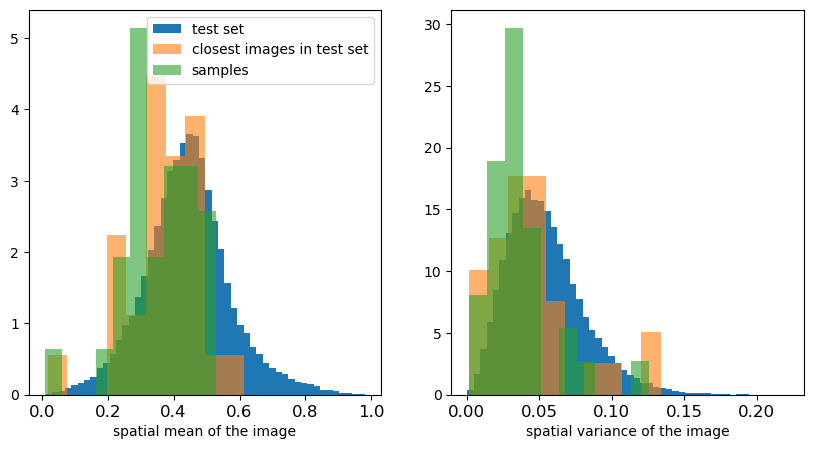

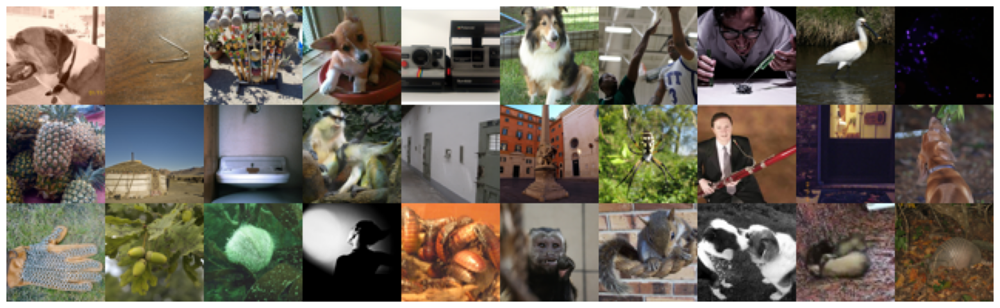

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


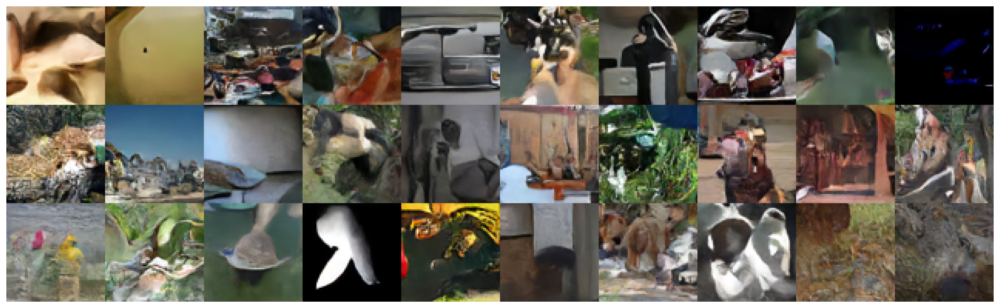

In [212]:
sig = 50
idx = similarity_matrix_2mats(sample_phis[group][sig][3].cpu(), torch.cat(phis[group][sig])).topk(1, dim = 1)[1].flatten()


f, axs = plt.subplots(1, 2, figsize = ( 2*5,5 ) , sharey=False)

axs[0].hist(test_sets_cat.mean(dim = (1,2,3))   , bins= 50 , label = 'test set ', density = True);
axs[0].hist(test_sets_cat[idx].cpu().mean(dim = (1,2,3)), bins= 10 , 
         label = 'closest images in test set', density = True, alpha = .6);
axs[0].hist(all_samples[group].cpu().mean(dim = (1,2,3)), bins= 10 , 
         label = 'samples', density = True, alpha = .6);
axs[0].legend()
axs[0].set_xlabel('spatial mean of the image');

axs[1].hist(test_sets_cat.var(dim = (1,2,3))   , bins= 50 , label = 'test set ', density = True);
axs[1].hist(test_sets_cat[idx].cpu().var(dim = (1,2,3)), bins= 10 , 
         label = 'closest images in test set', density = True, alpha = .6);
axs[1].hist(all_samples[group].cpu().var(dim = (1,2,3)), bins= 10 , 
         label = 'samples', density = True, alpha = .6);
axs[1].set_xlabel('spatial variance of the image');

# axs[1].legend();
show_im_grid(test_sets_cat[idx])
show_im_grid(all_samples[group] )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


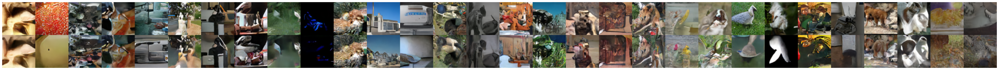

In [213]:
show_im_grid(torch.vstack([all_samples[group] for group in groups  ] ), n_columns=30)


## Are the specialized channels off for the sample's $\phi$s? 

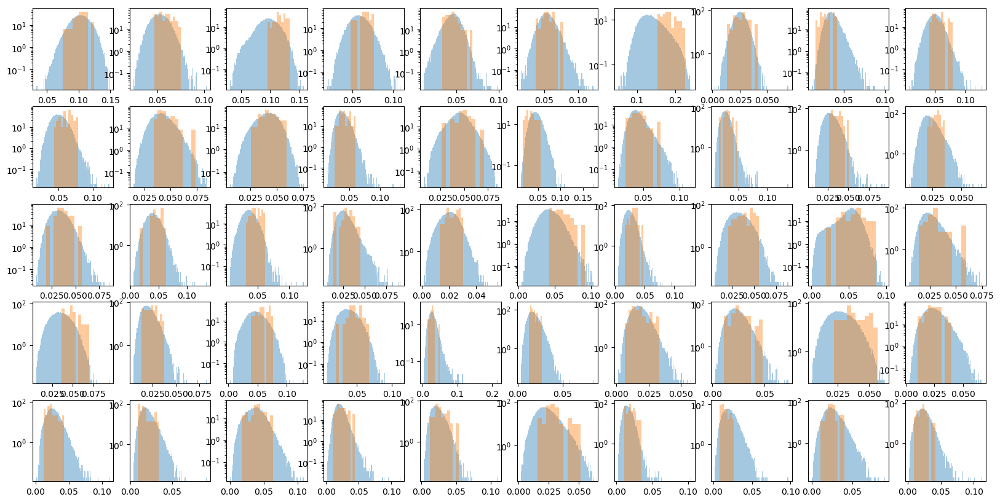

In [463]:
sample_phis = get_activation_means_unconditional(denoisers[group], all_samples[group] + sig/255 * torch.randn_like(all_samples[group]) )


f, axs = plt.subplots(5,10, figsize = (20, 10))
axs = axs.ravel()
i = 0
for ch_n in range(0, 50): 
    axs[i].hist(torch.cat(phis[group][sig])[:, ids_selectivity_sorted[group][sig].cpu() ][:,ch_n], density = True,  alpha = .4, bins = 100);
    axs[i].hist( sample_phis[3].cpu()[:, ids_selectivity_sorted[group][sig].cpu() ][:,ch_n], alpha = .4, density = True);
    axs[i].set_yscale('log')
    i += 1

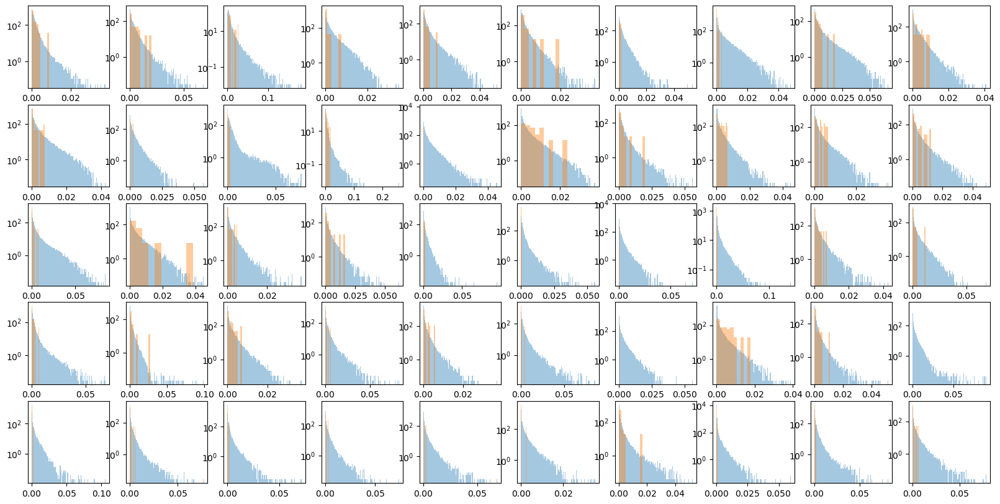

In [464]:

f, axs = plt.subplots(5,10, figsize = (20, 10))
axs = axs.ravel()
i = 0
for ch_n in range(250, 300): 
    axs[i].hist(torch.cat(phis[group][sig])[:, ids_selectivity_sorted[group][sig].cpu() ][:,ch_n], density = True,  alpha = .4, bins = 100);
    axs[i].hist( sample_phis[3].cpu()[:, ids_selectivity_sorted[group][sig].cpu() ][:,ch_n], alpha = .4, density = True);
    axs[i].set_yscale('log')
    i += 1

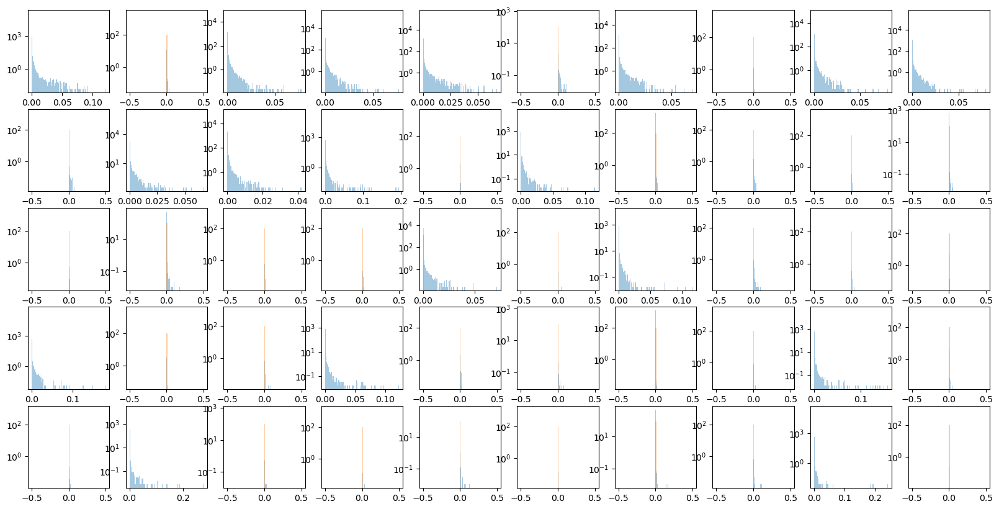

In [470]:
f, axs = plt.subplots(5,10, figsize = (20, 10))
axs = axs.ravel()
i = 0
for ch_n in range(512-50, 512): 
    axs[i].hist(torch.cat(phis[group][255]).cpu()[:, ids_selectivity_sorted[group][sig].cpu() ][:,ch_n], density = True,  alpha = .4,
                bins = 100);
    axs[i].hist( sample_phis[3].cpu()[:, ids_selectivity_sorted[group][sig].cpu() ][:,ch_n], alpha = .4, density = True, bins = 100);
    axs[i].set_yscale('log')
    i += 1